# Projet de fin de module

## 1. Le jeu de données

In [ ]:
# Importation des bibliothèques de préparations de données
import pandas as pd
import numpy as np

In [ ]:
# Importation du jeux de données

df= pd.read_csv('dataset_med.csv')

## 2. Phase de préparation des données

### 2.1 Analyse exploratoire des données

#### 2.1.1 Analyse exploratoire générale des données

In [ ]:
# Apercu des données (10 premières lignes)

df.head(10)

,id,age,gender,country,diagnosis_date,cancer_stage,family_history,smoking_status,bmi,cholesterol_level,hypertension,asthma,cirrhosis,other_cancer,treatment_type,end_treatment_date,survived
0,1,64.0,Male,Sweden,2016-04-05,Stage I,Yes,Passive Smoker,29.4,199,0,0,1,0,Chemotherapy,2017-09-10,0
1,2,50.0,Female,Netherlands,2023-04-20,Stage III,Yes,Passive Smoker,41.2,280,1,1,0,0,Surgery,2024-06-17,1
2,3,65.0,Female,Hungary,2023-04-05,Stage III,Yes,Former Smoker,44.0,268,1,1,0,0,Combined,2024-04-09,0
3,4,51.0,Female,Belgium,2016-02-05,Stage I,No,Passive Smoker,43.0,241,1,1,0,0,Chemotherapy,2017-04-23,0
4,5,37.0,Male,Luxembourg,2023-11-29,Stage I,No,Passive Smoker,19.7,178,0,0,0,0,Combined,2025-01-08,0
5,6,50.0,Male,Italy,2023-01-02,Stage I,No,Never Smoked,37.6,274,1,0,0,0,Radiation,2024-12-27,0
6,7,49.0,Female,Croatia,2018-05-21,Stage III,Yes,Passive Smoker,43.1,259,0,0,0,0,Radiation,2019-05-06,1
7,8,51.0,Male,Denmark,2017-02-18,Stage IV,Yes,Former Smoker,25.8,195,1,1,0,0,Combined,2017-08-26,0
8,9,64.0,Male,Sweden,2021-03-21,Stage III,Yes,Current Smoker,21.5,236,0,0,0,0,Chemotherapy,2022-03-07,0
9,10,56.0,Male,Hungary,2021-11-30,Stage IV,Yes,Current Smoker,17.3,183,1,0,0,1,Surgery,2023-11-29,0


In [ ]:
# Les dimensions du jeu de données

df.shape

(890000, 17)

Nous avons alors un jeu de données de 890000 lignes et 17 colonnes.

In [ ]:
# Les libellés des colonnes

df.columns

Index(['id', 'age', 'gender', 'country', 'diagnosis_date', 'cancer_stage',
       'family_history', 'smoking_status', 'bmi', 'cholesterol_level',
       'hypertension', 'asthma', 'cirrhosis', 'other_cancer', 'treatment_type',
       'end_treatment_date', 'survived'],
      dtype='object')

In [ ]:
# Les types de données de chaque colonne

df.dtypes

id                      int64
age                   float64
gender                 object
country                object
diagnosis_date         object
cancer_stage           object
family_history         object
smoking_status         object
bmi                   float64
cholesterol_level       int64
hypertension            int64
asthma                  int64
cirrhosis               int64
other_cancer            int64
treatment_type         object
end_treatment_date     object
survived                int64
dtype: object

Nous pouvons observer que nous avons 8 colonnes de type objet.

Nous allons devoir convertir ces colonnes en types plus appropriés pour l'analyse, dans la partie nettoyage.

In [ ]:
# Les types de données de chaque colonne, le nombre d'éléments non nuls et l'utilisation de la mémoire

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 890000 entries, 0 to 889999
Data columns (total 17 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   id                  890000 non-null  int64  
 1   age                 890000 non-null  float64
 2   gender              890000 non-null  object 
 3   country             890000 non-null  object 
 4   diagnosis_date      890000 non-null  object 
 5   cancer_stage        890000 non-null  object 
 6   family_history      890000 non-null  object 
 7   smoking_status      890000 non-null  object 
 8   bmi                 890000 non-null  float64
 9   cholesterol_level   890000 non-null  int64  
 10  hypertension        890000 non-null  int64  
 11  asthma              890000 non-null  int64  
 12  cirrhosis           890000 non-null  int64  
 13  other_cancer        890000 non-null  int64  
 14  treatment_type      890000 non-null  object 
 15  end_treatment_date  890000 non-nul

Nous pouvons observer que nous avons 0 colonnes avec des valeurs manquantes.

Nous n'aurons alors pas besoin de traiter les valeurs manquantes dans la partie de nettoyage des données.

In [ ]:
# Statistiques descriptives

df.describe()

,id,age,bmi,cholesterol_level,hypertension,asthma,cirrhosis,other_cancer,survived
count,890000.000000,890000.000000,890000.000000,890000.000000,890000.000000,890000.000000,890000.000000,890000.000000,890000.000000
mean,445000.500000,55.007008,30.494172,233.633916,0.750024,0.469740,0.225956,0.088157,0.220229
std,256921.014127,9.994485,8.368539,43.432278,0.432999,0.499084,0.418211,0.283524,0.414401
min,1.000000,4.000000,16.000000,150.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,222500.750000,48.000000,23.300000,196.000000,1.000000,0.000000,0.000000,0.000000,0.000000
50%,445000.500000,55.000000,30.500000,242.000000,1.000000,0.000000,0.000000,0.000000,0.000000
75%,667500.250000,62.000000,37.700000,271.000000,1.000000,1.000000,0.000000,0.000000,0.000000
max,890000.000000,104.000000,45.000000,300.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
# Les index des lignes

df.index

RangeIndex(start=0, stop=890000, step=1)

#### 2.1.2 Analyse exploratoire approfondie des données

Pour comprendre le jeux de données en profondeur nous allons requêter dessus.

##### Les variables catégorielles

In [ ]:
# Nous avions remarqué plus tôt de nombreuses variables catégorielles
# Nous allons chercher les valeurs uniques de chaque colonne catégorielle

for col in df.select_dtypes(include=['object']).columns:
    print(f"Colonne: {col}")
    print(df[col].unique())
    print("\n")


Colonne: gender
['Male' 'Female']


Colonne: country
['Sweden' 'Netherlands' 'Hungary' 'Belgium' 'Luxembourg' 'Italy' 'Croatia'
 'Denmark' 'Malta' 'Germany' 'Poland' 'Ireland' 'Romania' 'Spain' 'Greece'
 'Estonia' 'Cyprus' 'France' 'Slovenia' 'Latvia' 'Portugal' 'Austria'
 'Czech Republic' 'Finland' 'Lithuania' 'Slovakia' 'Bulgaria']


Colonne: diagnosis_date
['2016-04-05' '2023-04-20' '2023-04-05' ... '2017-12-27' '2021-04-22'
 '2020-04-02']


Colonne: cancer_stage
['Stage I' 'Stage III' 'Stage IV' 'Stage II']


Colonne: family_history
['Yes' 'No']


Colonne: smoking_status
['Passive Smoker' 'Former Smoker' 'Never Smoked' 'Current Smoker']


Colonne: treatment_type
['Chemotherapy' 'Surgery' 'Combined' 'Radiation']


Colonne: end_treatment_date
['2017-09-10' '2024-06-17' '2024-04-09' ... '2014-12-17' '2026-05-30'
 '2014-12-05']




Nous pouvons observer que les colonnes 'diagnosis_date' et 'treatment_type' sont des dates et non des valeurs catgorielles.

Elles sont de type objet, mais elles devraient être de type datetime pour plus de cohérence.

In [ ]:
# Nous allons convertir ces colonnes en type datetime

df['diagnosis_date'] = pd.to_datetime(df['diagnosis_date'], errors='coerce')
df['end_treatment_date'] = pd.to_datetime(df['end_treatment_date'], errors='coerce')

#'coerce' permet de convertir les valeurs qui ne peuvent pas être converties en NaT (Not a Time)

In [ ]:
# Les colonnes 'diagnosis_date' et 'treatment_type' sont maintenant de type datetime

print(df.dtypes)

id                             int64
age                          float64
gender                        object
country                       object
diagnosis_date        datetime64[ns]
cancer_stage                  object
family_history                object
smoking_status                object
bmi                          float64
cholesterol_level              int64
hypertension                   int64
asthma                         int64
cirrhosis                      int64
other_cancer                   int64
treatment_type                object
end_treatment_date    datetime64[ns]
survived                       int64
dtype: object


In [ ]:
# Nous vérifions si il y a des NaT dans les colonnes de type datetime
print(df['diagnosis_date'].isna().sum())
print(df['end_treatment_date'].isna().sum())

0
0


In [ ]:
# Nous alors reprendre notre exploration des données après ce nettoyage

for col in df.select_dtypes(include=['object']).columns:
    print(f"Colonne: {col}")
    print(df[col].unique())
    print("\n")

Colonne: gender
['Male' 'Female']


Colonne: country
['Sweden' 'Netherlands' 'Hungary' 'Belgium' 'Luxembourg' 'Italy' 'Croatia'
 'Denmark' 'Malta' 'Germany' 'Poland' 'Ireland' 'Romania' 'Spain' 'Greece'
 'Estonia' 'Cyprus' 'France' 'Slovenia' 'Latvia' 'Portugal' 'Austria'
 'Czech Republic' 'Finland' 'Lithuania' 'Slovakia' 'Bulgaria']


Colonne: cancer_stage
['Stage I' 'Stage III' 'Stage IV' 'Stage II']


Colonne: family_history
['Yes' 'No']


Colonne: smoking_status
['Passive Smoker' 'Former Smoker' 'Never Smoked' 'Current Smoker']


Colonne: treatment_type
['Chemotherapy' 'Surgery' 'Combined' 'Radiation']




In [ ]:
# Nous voulons le nombre de valeurs uniques de chaque variable catégorielle 'objet'

unique_counts = df.select_dtypes(include=['object']).nunique()
print(unique_counts)

gender             2
country           27
cancer_stage       4
family_history     2
smoking_status     4
treatment_type     4
dtype: int64


In [ ]:
# Nous pouvons faire des observations sur les décès en fonction du genre
deces_genre = df[df['survived'] == 0].groupby('gender').size().reset_index(name='count')
deces_genre

,gender,count
0,Female,347034
1,Male,346962


In [ ]:
# Nous pouvons aussi faire des observations sur les pays d'origine des patients
# En triant les pays par le nombre de patients du plus élevé au plus bas
pays_origine = df.groupby('country').size().reset_index(name='count').sort_values(by='count', ascending=False)
pays_origine

,country,count
18,Malta,33367
13,Ireland,33243
21,Portugal,33208
9,France,33199
26,Sweden,33161
3,Croatia,33138
11,Greece,33052
25,Spain,33042
19,Netherlands,33040
6,Denmark,33024


Ici, il s'agit uniquement d'une exploration des données.

Pour une analyse plus approfondie, nous ferons des visualisations des tandances plus tard.

##### Les variables numériques

In [ ]:
# Identification des variables numériques int et float
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
print("Colonnes numériques :")
print(numerical_cols)



Colonnes numériques :
Index(['id', 'age', 'bmi', 'cholesterol_level', 'hypertension', 'asthma',
       'cirrhosis', 'other_cancer', 'survived'],
      dtype='object')


In [ ]:
# Identification des valeurs uniques de chaque colonne numérique
for col in numerical_cols:
    print(f"Colonne: {col}")
    print(df[col].unique())
    print("\n")
    

Colonne: id
[     1      2      3 ... 889998 889999 890000]


Colonne: age
[ 64.  50.  65.  51.  37.  49.  56.  48.  47.  67.  45.  46.  21.  62.
  60.  57.  36.  61.  71.  74.  35.  54.  44.  68.  59.  58.  63.  69.
  70.  52.  40.  78.  75.  72.  42.  53.  39.  66.  41.  43.  55.  38.
  30.  34.  76.  73.  80.  31.  85.  28.  79.  87.  77.  33.  32.  25.
  90.  84.  81.  27.  82.  83.  22.  86.  26.  93.  29.  23.  19.  24.
  89.  18.  91.  95.  88.  20.  94. 101.  15.  92.  16.  17.  10.  14.
  99.  13.  97.   9.  12.  98.   7.  96.   4. 104.   8.]


Colonne: bmi
[29.4 41.2 44.  43.  19.7 37.6 43.1 25.8 21.5 17.3 30.7 33.9 25.6 26.3
 42.7 19.6 21.7 23.1 43.4 36.8 24.6 16.  38.  34.8 24.  39.4 17.8 31.8
 23.4 43.2 34.6 28.9 19.5 23.5 40.9 44.1 32.  20.6 42.4 28.  21.8 44.2
 38.3 19.8 36.  33.2 22.  30.5 45.  20.5 21.  32.5 17.6 31.2 16.1 43.5
 37.2 37.1 25.1 26.4 21.2 26.9 32.1 17.2 23.8 38.8 22.9 16.4 33.8 31.9
 19.9 25.7 18.7 38.2 20.9 43.7 19.3 17.9 20.1 31.7 42.6 44.9 26.  41.6
 

Nous remarquons que les colonnes 'hypertension', 'asthma', 'cirrhosis', 'other_cancer' et 'survived' sont encodées en 0 et 1.

0 correpond à "non" et 1 correspond à "oui".

In [ ]:
# Nous pouvons calculer l'age moyen des patients

age_moyenne = df['age'].mean()
print(f"L'âge moyen des patients est de {age_moyenne:.2f} ans.")



L'âge moyen des patients est de 55.01 ans.


In [ ]:
# Nous pouvons calculer quelle est la moyenne des patients qui ont survécu en n'ayant pas d'autre cancer
# et la moyenne des patients qui ont survécu en ayant un autre cancer

survived_other_cancer = df.groupby('other_cancer')['survived'].mean().reset_index()
print("Moyenne des patients qui ont survécu en ayant 'other_cancer' = 0 et 1 :")    
print(survived_other_cancer)

Moyenne des patients qui ont survécu en ayant 'other_cancer' = 0 et 1 :
   other_cancer  survived
0             0  0.220483
1             1  0.217601


##### Les variables temporelles

In [ ]:
# Identifier les variables temporelles
temporal_cols = df.select_dtypes(include=['datetime64[ns]']).columns
print("Colonnes temporelles :") 
print(temporal_cols)

Colonnes temporelles :
Index(['diagnosis_date', 'end_treatment_date'], dtype='object')


In [ ]:
# Nous observons les extremes des dates de diagnostic et de fin de traitement
print("Date de diagnostic la plus ancienne :", df['diagnosis_date'].min())
print("Date de diagnostic la plus récente :", df['diagnosis_date'].max())

print("Date de fin de traitement la plus ancienne :", df['end_treatment_date'].min())
print("Date de fin de traitement la plus récente :", df['end_treatment_date'].max())

Date de diagnostic la plus ancienne : 2014-06-02 00:00:00
Date de diagnostic la plus récente : 2024-05-30 00:00:00
Date de fin de traitement la plus ancienne : 2014-12-02 00:00:00
Date de fin de traitement la plus récente : 2026-05-30 00:00:00


Les dates de fin de traitement postérerieures à la date actuelle, ce qui signifie que pour certains patients la date de fin de traitement est hypothétique.

La date de fin de traitement est postérieure à la date de diagnostic pour tous les patients, ce qui est alors cohérent.

### 2.2 Nettoyage des données

In [ ]:
df.head(10)

,id,age,gender,country,diagnosis_date,cancer_stage,family_history,smoking_status,bmi,cholesterol_level,hypertension,asthma,cirrhosis,other_cancer,treatment_type,end_treatment_date,survived
0,1,64.0,Male,Sweden,2016-04-05,Stage I,Yes,Passive Smoker,29.4,199,0,0,1,0,Chemotherapy,2017-09-10,0
1,2,50.0,Female,Netherlands,2023-04-20,Stage III,Yes,Passive Smoker,41.2,280,1,1,0,0,Surgery,2024-06-17,1
2,3,65.0,Female,Hungary,2023-04-05,Stage III,Yes,Former Smoker,44.0,268,1,1,0,0,Combined,2024-04-09,0
3,4,51.0,Female,Belgium,2016-02-05,Stage I,No,Passive Smoker,43.0,241,1,1,0,0,Chemotherapy,2017-04-23,0
4,5,37.0,Male,Luxembourg,2023-11-29,Stage I,No,Passive Smoker,19.7,178,0,0,0,0,Combined,2025-01-08,0
5,6,50.0,Male,Italy,2023-01-02,Stage I,No,Never Smoked,37.6,274,1,0,0,0,Radiation,2024-12-27,0
6,7,49.0,Female,Croatia,2018-05-21,Stage III,Yes,Passive Smoker,43.1,259,0,0,0,0,Radiation,2019-05-06,1
7,8,51.0,Male,Denmark,2017-02-18,Stage IV,Yes,Former Smoker,25.8,195,1,1,0,0,Combined,2017-08-26,0
8,9,64.0,Male,Sweden,2021-03-21,Stage III,Yes,Current Smoker,21.5,236,0,0,0,0,Chemotherapy,2022-03-07,0
9,10,56.0,Male,Hungary,2021-11-30,Stage IV,Yes,Current Smoker,17.3,183,1,0,0,1,Surgery,2023-11-29,0


In [ ]:
# Nous renommons la colonne 'bmi' avec un libellé plus explicite
# 'bmi' est l'acronyme de Body Mass Index, ou Indice de Masse Corporelle en français
df.rename(columns={'bmi': 'body_mass_index'}, inplace=True)

In [ ]:
# Traitement des valeurs manquantes
# Nous savons qu'il n'y a pas de valeurs manquantes dans le jeu de données
# Passons à la suite

In [ ]:
# Traitement des doublons
# Vérification des doublons dans le jeu de données
duplicates = df.duplicated().sum()
print(f"Nombre de doublons dans le jeu de données : {duplicates}")

Nombre de doublons dans le jeu de données : 0


In [ ]:
# Traitement des incohérences
# Vérification des incohérences dans les données
# Vérification des dates de fin de traitement sont postérieures aux dates de diagnostic
incoherences_dates = df[df['end_treatment_date'] < df['diagnosis_date']]
print(f"Nombre d'incohérences de dates : {len(incoherences_dates)}")

# Egalement, nous vérifions si les valeurs de 'body_mass_index' sont cohérentes
incoherences_bmi = df[(df['body_mass_index'] < 10) | (df['body_mass_index'] > 50)]
print(f"Nombre d'incohérences de 'body_mass_index' : {len(incoherences_bmi)}")

# Ensuite, nous vérifions si les valeurs de 'age' sont cohérentes
incoherences_age = df[(df['age'] < 0) | (df['age'] > 120)]
print(f"Nombre d'incohérences d'age : {len(incoherences_age)}")



Nombre d'incohérences de dates : 0
Nombre d'incohérences de 'body_mass_index' : 0
Nombre d'incohérences d'age : 0


In [ ]:
# Pour plus de clarté, nous passons la colonne 'id' en index
df.set_index('id', inplace=True)

In [ ]:
# La colonne 'age' est en float 
# Il serait plus approprié de la convertir en int
df['age'] = df['age'].astype(int)

In [ ]:
# On remarque que pour certaines variables nous avons 'Yes' 'No' et pour d'autres 1 et 0
# On va uniformiser les valeurs pour les variables catégorielles
# les 1 seront remplacés par 'Yes' et les 0 par 'No'

binary_cols = ['hypertension', 'asthma', 'cirrhosis', 'other_cancer', 'survived']
for col in binary_cols:
    df[col] = df[col].replace({1: 'Yes', 0: 'No'})


In [ ]:
# Traitement des valeurs aberrantes
# Recherche les valeurs aberrantes dans les colonnes numériques

# Définir 'numerical_cols' ici
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Utilisation de la méthode de l'écart interquartile (IQR) pour détecter les valeurs aberrantes
# L'IQR est la différence entre le troisième quartile (Q3) et le premier quartile (Q1)
for col in numerical_cols:
    if col != 'id':  # On ne traite pas la colonne 'id'
        q1 = df[col].quantile(0.25)
        q3 = df[col].quantile(0.75)
        iqr = q3 - q1
        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr
        outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
        print(f"Nombre de valeurs aberrantes dans la colonne {col} : {len(outliers)}")


Nombre de valeurs aberrantes dans la colonne age : 3895
Nombre de valeurs aberrantes dans la colonne body_mass_index : 0
Nombre de valeurs aberrantes dans la colonne cholesterol_level : 0


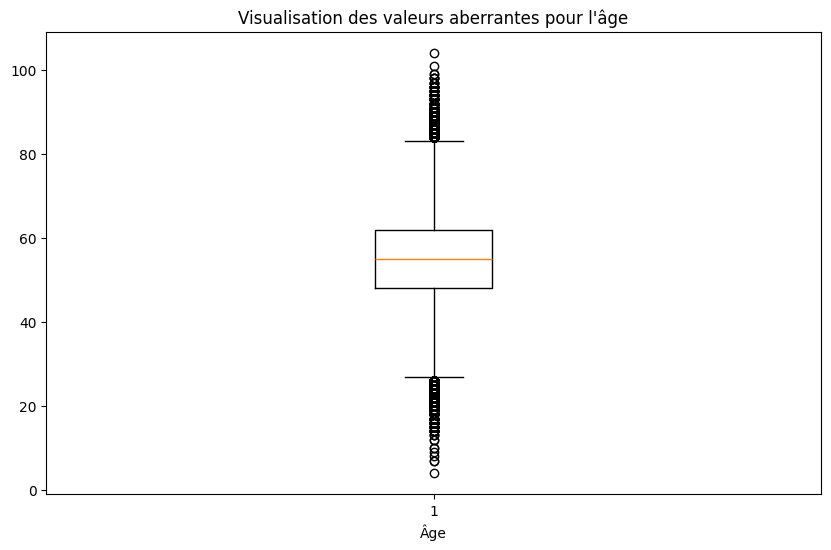

In [ ]:
# Visualisation des valeurs aberantes pour la colonne 'age'

import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.boxplot(df['age'])
plt.title('Visualisation des valeurs aberrantes pour l\'âge')
plt.xlabel('Âge')
plt.show()


La majorité des patients ont un âge compris entre environ 50 et 60 ans, mais il existe quelques patients beaucoup plus jeunes ou plus âgés, considérés comme des valeurs aberrantes.

Nous ne supprimons pas ces valeurs aberrantes car elles peuvent représenter des cas réels et intéressants à étudier.

In [ ]:
# Le dataframe nettoyé
df.head(10)

,age,gender,country,diagnosis_date,cancer_stage,family_history,smoking_status,body_mass_index,cholesterol_level,hypertension,asthma,cirrhosis,other_cancer,treatment_type,end_treatment_date,survived
id,,,,,,,,,,,,,,,,
1,64,Male,Sweden,2016-04-05,Stage I,Yes,Passive Smoker,29.4,199,No,No,Yes,No,Chemotherapy,2017-09-10,No
2,50,Female,Netherlands,2023-04-20,Stage III,Yes,Passive Smoker,41.2,280,Yes,Yes,No,No,Surgery,2024-06-17,Yes
3,65,Female,Hungary,2023-04-05,Stage III,Yes,Former Smoker,44.0,268,Yes,Yes,No,No,Combined,2024-04-09,No
4,51,Female,Belgium,2016-02-05,Stage I,No,Passive Smoker,43.0,241,Yes,Yes,No,No,Chemotherapy,2017-04-23,No
5,37,Male,Luxembourg,2023-11-29,Stage I,No,Passive Smoker,19.7,178,No,No,No,No,Combined,2025-01-08,No
6,50,Male,Italy,2023-01-02,Stage I,No,Never Smoked,37.6,274,Yes,No,No,No,Radiation,2024-12-27,No
7,49,Female,Croatia,2018-05-21,Stage III,Yes,Passive Smoker,43.1,259,No,No,No,No,Radiation,2019-05-06,Yes
8,51,Male,Denmark,2017-02-18,Stage IV,Yes,Former Smoker,25.8,195,Yes,Yes,No,No,Combined,2017-08-26,No
9,64,Male,Sweden,2021-03-21,Stage III,Yes,Current Smoker,21.5,236,No,No,No,No,Chemotherapy,2022-03-07,No


## 3.  Création de variables

In [ ]:
# Nous allons générer 4 nouvelles variables à partir des données existantes
# Création d'une nouvelle variable 'treatment_duration' qui correspond à la durée du traitement en jours
df['treatment_duration'] = (df['end_treatment_date'] - df['diagnosis_date']).dt.days

# Création d'une nouvelle variable 'autre_pathologie' qui correspond à la présence d'autres pathologies
df['autre_pathologie'] = df[['hypertension', 'asthma', 'cirrhosis', 'other_cancer']].apply(lambda x: 'Yes' if 'Yes' in x.values else 'No', axis=1)

# Création d'une nouvelle variable de tranches d'âge 'age_group'
# En regroupant les âges en tranches on peut:
#- faire des comparaisons entre les différentes tranches
#- observer des différences de comportement ou de survie par groupe
# Cela permet aussi d'améliorer les visualisations
df['age_group'] = pd.cut(df['age'],
                         bins=[0, 18, 30, 60, 80, 120],
                         labels=['Child/Teenagers', 'Young adult', 'Adult', 'Senior', 'Very elderly'])

# Création d'une nouvelle variable de catégorie d'IMC : 'bmi_category'
# L’IMC (Body Mass Index) étant un facteur de santé très utilisé, faire une catégorisation permet de:
#- analyser les taux de survie par catégorie d’IMC
#- rendre les graphiques plus lisibles
def classify_bmi(body_mass_index):
    if body_mass_index < 18.5:
        return 'Underweight'
    elif body_mass_index < 25:
        return 'Normal'
    elif body_mass_index < 30:
        return 'Overweight'
    else:
        return 'Obesity'

df['bmi_category'] = df['body_mass_index'].apply(classify_bmi)

In [ ]:
df.head(10)

,age,gender,country,diagnosis_date,cancer_stage,family_history,smoking_status,body_mass_index,cholesterol_level,hypertension,asthma,cirrhosis,other_cancer,treatment_type,end_treatment_date,survived,treatment_duration,autre_pathologie,age_group,bmi_category
id,,,,,,,,,,,,,,,,,,,,
1,64,Male,Sweden,2016-04-05,Stage I,Yes,Passive Smoker,29.4,199,No,No,Yes,No,Chemotherapy,2017-09-10,No,523,Yes,Senior,Overweight
2,50,Female,Netherlands,2023-04-20,Stage III,Yes,Passive Smoker,41.2,280,Yes,Yes,No,No,Surgery,2024-06-17,Yes,424,Yes,Adult,Obesity
3,65,Female,Hungary,2023-04-05,Stage III,Yes,Former Smoker,44.0,268,Yes,Yes,No,No,Combined,2024-04-09,No,370,Yes,Senior,Obesity
4,51,Female,Belgium,2016-02-05,Stage I,No,Passive Smoker,43.0,241,Yes,Yes,No,No,Chemotherapy,2017-04-23,No,443,Yes,Adult,Obesity
5,37,Male,Luxembourg,2023-11-29,Stage I,No,Passive Smoker,19.7,178,No,No,No,No,Combined,2025-01-08,No,406,No,Adult,Normal
6,50,Male,Italy,2023-01-02,Stage I,No,Never Smoked,37.6,274,Yes,No,No,No,Radiation,2024-12-27,No,725,Yes,Adult,Obesity
7,49,Female,Croatia,2018-05-21,Stage III,Yes,Passive Smoker,43.1,259,No,No,No,No,Radiation,2019-05-06,Yes,350,No,Adult,Obesity
8,51,Male,Denmark,2017-02-18,Stage IV,Yes,Former Smoker,25.8,195,Yes,Yes,No,No,Combined,2017-08-26,No,189,Yes,Adult,Overweight
9,64,Male,Sweden,2021-03-21,Stage III,Yes,Current Smoker,21.5,236,No,No,No,No,Chemotherapy,2022-03-07,No,351,No,Senior,Normal


## 4. Visualisation des données

In [ ]:
# Utilisez différents types de graphiques pour illustrer les tendances et relations

C:\Users\LéaGravellard\AppData\Local\Temp\ipykernel_884\864544109.py:32: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



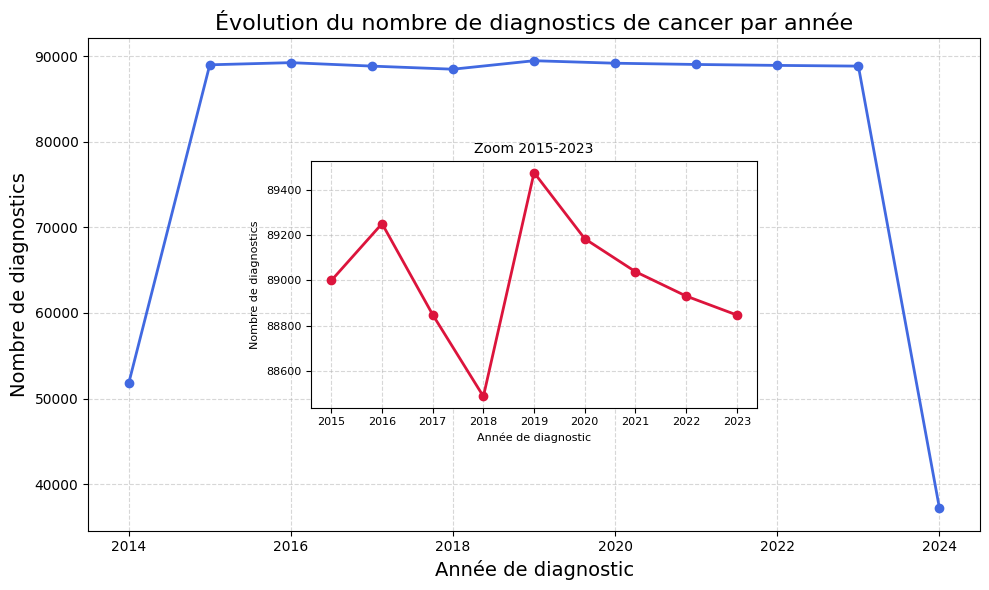

In [ ]:
# Graphique 1 : Zoom sur l'évolution du nombre de diagnostics de cancer

import matplotlib.pyplot as plt

# Création d'une variable 'diagnosis_per_year' qui compte le nombre de diagnostics par année
df['diagnosis_year'] = df['diagnosis_date'].dt.year
diagnosis_per_year = df['diagnosis_year'].value_counts().sort_index()

# Données globales
plt.figure(figsize=(10, 6))
plt.plot(diagnosis_per_year.index, diagnosis_per_year.values, marker='o', color='royalblue', linewidth=2)
plt.title("Évolution du nombre de diagnostics de cancer par année", fontsize=16)
plt.xlabel("Année de diagnostic", fontsize=14)
plt.ylabel("Nombre de diagnostics", fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)

# Ajout du zoom
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

ax = plt.gca()
axins = inset_axes(ax, width="50%", height="50%", loc='center', borderpad=2)

# Filtrer les années 2015 à 2023
mask = (diagnosis_per_year.index >= 2015) & (diagnosis_per_year.index <= 2023)
axins.plot(diagnosis_per_year.index[mask], diagnosis_per_year.values[mask], marker='o', color='crimson', linewidth=2)
axins.set_title("Zoom 2015-2023", fontsize=10)
axins.set_xlabel("Année de diagnostic", fontsize=8)
axins.set_ylabel("Nombre de diagnostics", fontsize=8)
axins.tick_params(axis='both', labelsize=8)
axins.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

In [ ]:
# Graphique 1 interactif : Zoom sur l'évolution du nombre de diagnostics de cancer

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Préparation des données
df['diagnosis_year'] = df['diagnosis_date'].dt.year
diagnosis_per_year = df['diagnosis_year'].value_counts().sort_index()

# Valeurs min et max pour le slider
min_year = int(diagnosis_per_year.index.min())
max_year = int(diagnosis_per_year.index.max())

# Valeurs par défaut pour le zoom (modifiable)
annee_debut = 2015
annee_fin = 2023

# Masque pour la période de zoom
mask = (diagnosis_per_year.index >= annee_debut) & (diagnosis_per_year.index <= annee_fin)

# Création des subplots
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Évolution globale", f"Zoom {annee_debut}-{annee_fin}"),
    shared_yaxes=False
)

# Courbe globale
fig.add_trace(
    go.Scatter(
        x=diagnosis_per_year.index,
        y=diagnosis_per_year.values,
        mode='lines+markers',
        name='Total',
        line=dict(color='royalblue', width=2)
    ),
    row=1, col=1
)

# Courbe zoomée
fig.add_trace(
    go.Scatter(
        x=diagnosis_per_year.index[mask],
        y=diagnosis_per_year.values[mask],
        mode='lines+markers',
        name=f'Zoom {annee_debut}-{annee_fin}',
        line=dict(color='crimson', width=2)
    ),
    row=1, col=2
)

fig.update_layout(
    title={
        'text': "Évolution du nombre de diagnostics de cancer par année (zoom inclus)",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis_title="Année de diagnostic",
    yaxis_title="Nombre de diagnostics",
    width=1000,
    height=400
)
fig.update_xaxes(title_text="Année de diagnostic", row=1, col=1)
fig.update_xaxes(title_text="Année de diagnostic", row=1, col=2)
fig.update_yaxes(title_text="Nombre de diagnostics", row=1, col=1)
fig.update_yaxes(title_text="Nombre de diagnostics", row=1, col=2)

fig.update_xaxes(rangeslider=dict(visible=True), row=1, col=1)
fig.update_xaxes(rangeslider=dict(visible=True), row=1, col=2)

fig.show()

In [ ]:
# Suppression de la variable 'diagnosis_year' du dataframe
df.drop(columns=['diagnosis_year'], inplace=True)

C:\Users\LéaGravellard\AppData\Local\Temp\ipykernel_884\3635021217.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




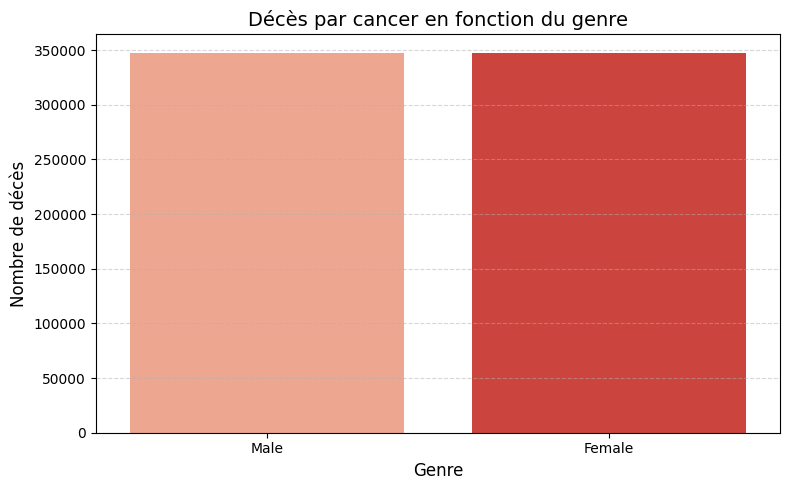

In [ ]:
# Graphique 2 : Montre les morts d'un cancer en fonction du genre

import matplotlib.pyplot as plt
import seaborn as sns

# Filtrer les décès
deces = df[df['survived'] == 'No']

plt.figure(figsize=(8, 5))
sns.countplot(data=deces, x='gender', palette='Reds')
plt.xlabel('Genre', fontsize=12)
plt.ylabel('Nombre de décès', fontsize=12)
plt.title("Décès par cancer en fonction du genre", fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

In [ ]:
# Graphique 2 interactif : Montre les morts d'un cancer en fonction du genre

import plotly.express as px

# --- Filtres à définir manuellement ---
# Exemple de sélection (remplace par tes valeurs ou variables)
selected_pays2 = df['country'].dropna().unique().tolist()  # ou ['France', 'Algeria']
selected_age_groups2 = df['age_group'].dropna().unique().tolist()  # ou ['30-40', '40-50']
selected_bmi_categories2 = df['bmi_category'].dropna().unique().tolist()  # ou ['Normal', 'Obese']

# Appliquer les filtres
df_graph2 = df[
    (df['country'].isin(selected_pays2)) &
    (df['age_group'].isin(selected_age_groups2)) &
    (df['bmi_category'].isin(selected_bmi_categories2))
]
deces = df_graph2[df_graph2['survived'] == 'No']

fig = px.bar(
    deces.groupby('gender').size().reset_index(name='count'),
    x='gender',
    y='count',
    color='gender',
    color_discrete_sequence=px.colors.qualitative.Set2,
    title="Décès par cancer en fonction du genre",
    labels={'gender': 'Genre', 'count': 'Nombre de décès'}
)
fig.update_layout(
    title={
        'text': "Décès par cancer en fonction du genre",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis_title='Genre',
    yaxis_title='Nombre de décès'
)
fig.show()

In [ ]:
# Vérification de la répartition des décès par genre
print(deces['gender'].value_counts())
print(deces['gender'].unique())

gender
Female    347034
Male      346962
Name: count, dtype: int64
['Male' 'Female']


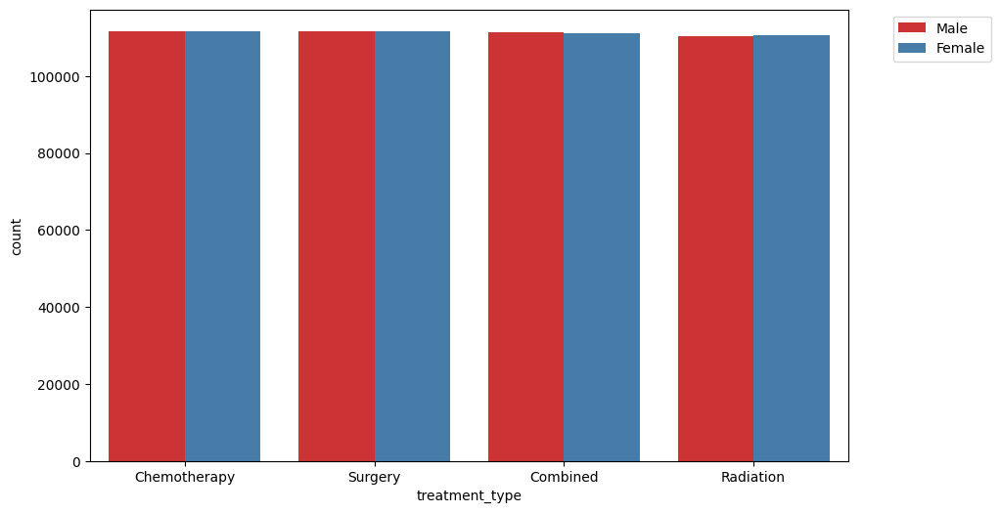

In [ ]:
# Graphique 3 : L'évolution de la durée de traitement en fonction des années de diagnostic

import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='treatment_type', hue='gender', palette='Set1')

plt.legend(bbox_to_anchor=(1.05, 1))

In [ ]:
# Graphique 3 interactif : L'évolution de la durée de traitement en fonction des années de diagnostic

import plotly.express as px

fig = px.histogram(
    df,
    x="treatment_type",
    color="gender",
    barmode="group",
    title="Évolution de la durée de traitement en fonction du type de traitement et du genre",
    labels={"treatment_type": "Type de traitement", "count": "Nombre de patients", "gender": "Genre"},
    color_discrete_sequence=px.colors.qualitative.Set1
)
fig.update_layout(
    xaxis_title="Type de traitement",
    yaxis_title="Nombre de patients",
    legend_title="Genre"
)
fig.show()


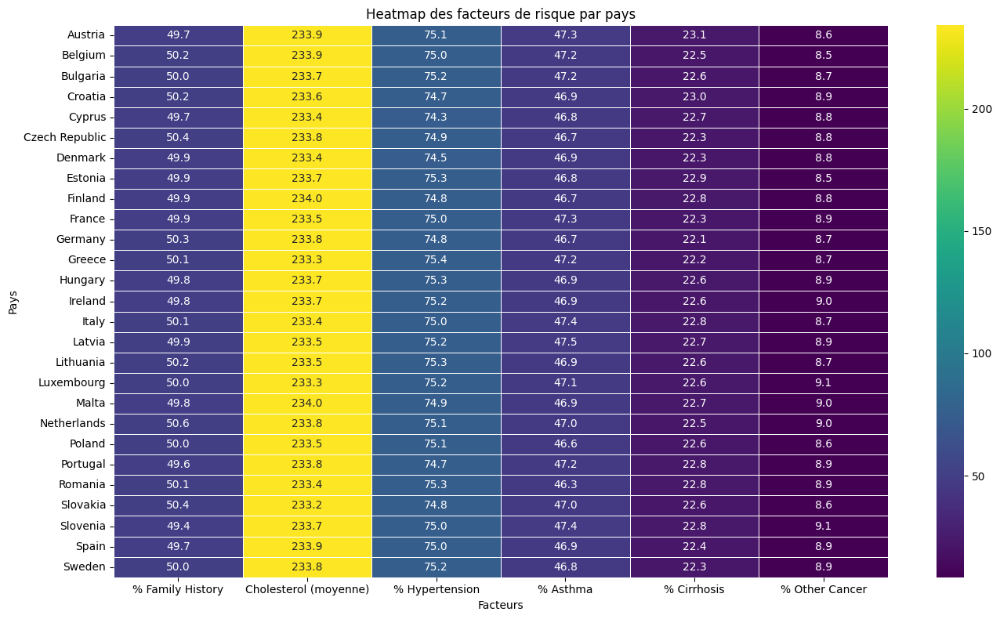

In [ ]:
# Graphique 4 : Heatmap des facteurs de risque par pays

import matplotlib.pyplot as plt
import seaborn as sns

# Calculer les pourcentages/moyennes par pays
heatmap_data = df.groupby('country').agg({
    'family_history': lambda x: (x == 'Yes').mean() * 100,
    'cholesterol_level': 'mean',
    'hypertension': lambda x: (x == 'Yes').mean() * 100,
    'asthma': lambda x: (x == 'Yes').mean() * 100,
    'cirrhosis': lambda x: (x == 'Yes').mean() * 100,
    'other_cancer': lambda x: (x == 'Yes').mean() * 100
})

# Renommer les colonnes pour plus de clarté
heatmap_data.rename(columns={
    'family_history': '% Family History',
    'cholesterol_level': 'Cholesterol (moyenne)',
    'hypertension': '% Hypertension',
    'asthma': '% Asthma',
    'cirrhosis': '% Cirrhosis',
    'other_cancer': '% Other Cancer'
}, inplace=True)

plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data, annot=True, fmt=".1f", cmap='viridis', linewidths=0.5)
plt.title("Heatmap des facteurs de risque par pays")
plt.ylabel("Pays")
plt.xlabel("Facteurs")
plt.tight_layout()
plt.show()

In [ ]:
# Graphique 4 interactif : Heatmap des facteurs de risque par pays

import plotly.express as px

fig = px.imshow(
    heatmap_data.values,
    labels=dict(x="Facteurs", y="Pays", color="Valeur"),
    x=heatmap_data.columns,
    y=heatmap_data.index,
    color_continuous_scale="viridis",
    text_auto=".1f",
    aspect="auto"  # Permet d'ajuster automatiquement l'aspect
)

fig.update_layout(
    title="Heatmap interactive des facteurs de risque par pays",
    title_x=0.5,
    xaxis_title="Facteurs",
    yaxis_title="Pays",
    width=1200,
    height=30 * len(heatmap_data),
    font=dict(size=12),
    coloraxis_colorbar=dict(
        len=1,        # Prend toute la hauteur de la heatmap
        y=0.5,        # Centre la barre verticalement
        thickness=20  # Largeur de la barre (optionnel)
    )
)

fig.update_xaxes(tickangle=0)  # Garde les labels horizontaux

fig.show()

C:\Users\LéaGravellard\AppData\Local\Temp\ipykernel_884\1097991265.py:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




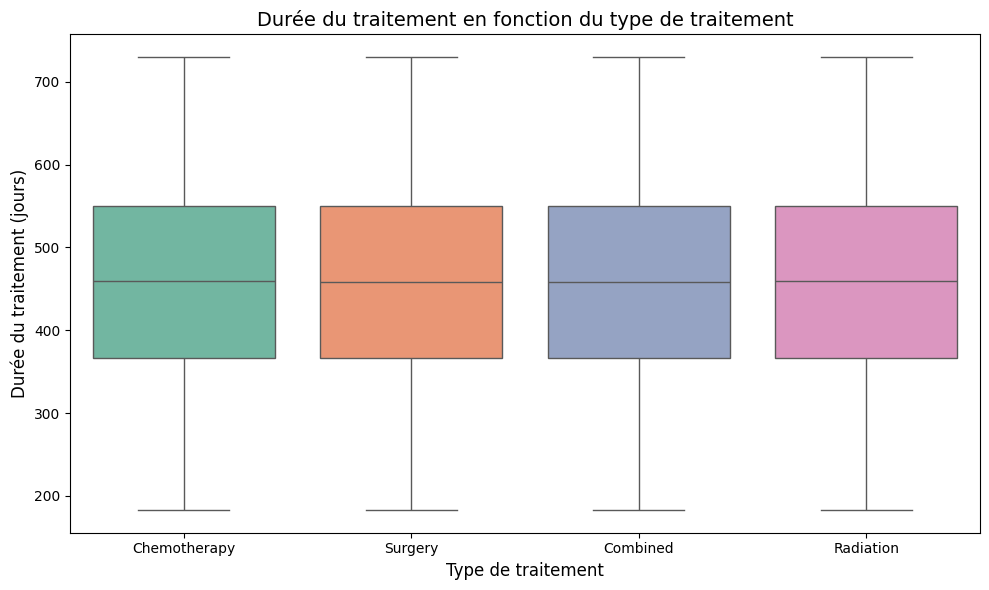

In [ ]:
# Graphique 5 : Durée du traitement en fonction du type de traitement

import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='treatment_type', y='treatment_duration', palette='Set2')
plt.xlabel("Type de traitement", fontsize=12)
plt.ylabel("Durée du traitement (jours)", fontsize=12)
plt.title("Durée du traitement en fonction du type de traitement", fontsize=14)
plt.tight_layout()
plt.show()

In [ ]:
# Graphique 5 : Durée du traitement en fonction du type de traitement

import plotly.express as px

# --- Filtres à définir manuellement ---
# Exemple de sélection (remplace par tes valeurs ou variables)
selected_genres5 = df['gender'].dropna().unique().tolist()         # ou ['Male', 'Female']
selected_pays5 = df['country'].dropna().unique().tolist()          # ou ['France', 'Algeria']
selected_treatments5 = df['treatment_type'].dropna().unique().tolist()  # ou ['Chirurgie', 'Chimiothérapie']

# Appliquer les filtres
df_graph5 = df[
    (df['gender'].isin(selected_genres5)) &
    (df['country'].isin(selected_pays5)) &
    (df['treatment_type'].isin(selected_treatments5))
]

fig = px.box(
    df_graph5,
    x="treatment_type",
    y="treatment_duration",
    color="treatment_type",
    color_discrete_sequence=px.colors.qualitative.Set2,
    title="Durée du traitement en fonction du type de traitement",
    labels={
        "treatment_type": "Type de traitement",
        "treatment_duration": "Durée du traitement (jours)"
    }
)
fig.update_layout(
    title={
        'text': "Durée du traitement en fonction du type de traitement",
        'x': 0.5,
        'xanchor': 'center'
    },
    xaxis_title="Type de traitement",
    yaxis_title="Durée du traitement (jours)"
)
fig.show()

In [ ]:
# Vérifie le nombre de valeurs par type de traitement
print(df['treatment_type'].value_counts(dropna=False))

# Vérifie les statistiques descriptives par type de traitement
print(df.groupby('treatment_type')['treatment_duration'].describe())

treatment_type
Chemotherapy    223262
Surgery         223261
Combined        222609
Radiation       220868
Name: count, dtype: int64
                   count        mean         std    min    25%    50%    75%  \
treatment_type                                                                 
Chemotherapy    223262.0  458.395401  139.140191  183.0  367.0  459.0  550.0   
Combined        222609.0  457.815219  139.360480  183.0  366.0  458.0  550.0   
Radiation       220868.0  458.403205  139.315637  183.0  367.0  459.0  550.0   
Surgery         223261.0  457.737446  139.487188  183.0  366.0  458.0  550.0   

                  max  
treatment_type         
Chemotherapy    730.0  
Combined        730.0  
Radiation       730.0  
Surgery         730.0  


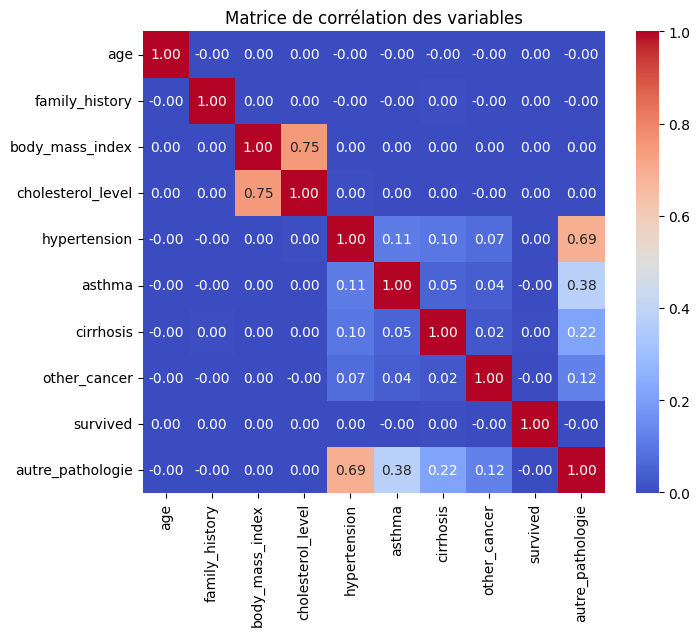

In [ ]:
# Graphique 6 : Matrice de corrélation
# Corrélation uniquement sur les colonnes numériques

# Copie du dataframe pour ne pas modifier l'original
df_corr = df.copy()

# Colonnes à encoder
cols_to_encode = ['hypertension', 'asthma', 'cirrhosis', 'other_cancer', 'survived', 'autre_pathologie', 'family_history']
for col in cols_to_encode:
    if col in df_corr.columns:
        df_corr[col] = df_corr[col].map({'Yes': 1, 'No': 0})

# Exclure la variable 'treatment_duration' de la matrice de corrélation
if 'treatment_duration' in df_corr.columns:
    df_corr = df_corr.drop(columns=['treatment_duration'])

correlation_matrix = df_corr.corr(numeric_only=True)

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title("Matrice de corrélation des variables")
plt.show()


In [ ]:
# Graphique 6 intractif : Matrice de corrélation
import plotly.express as px

# Copie du dataframe pour ne pas modifier l'original
df_corr = df.copy()

# Colonnes à encoder
cols_to_encode = ['hypertension', 'asthma', 'cirrhosis', 'other_cancer', 'survived', 'autre_pathologie', 'family_history']
for col in cols_to_encode:
    if col in df_corr.columns:
        df_corr[col] = df_corr[col].map({'Yes': 1, 'No': 0})

# Exclure la variable 'treatment_duration' de la matrice de corrélation
if 'treatment_duration' in df_corr.columns:
    df_corr = df_corr.drop(columns=['treatment_duration'])

correlation_matrix = df_corr.corr(numeric_only=True)

fig = px.imshow(
    correlation_matrix,
    text_auto=".2f",
    color_continuous_scale="RdBu",  # ou "Blues" pour bleu clair
    aspect="auto"
)

fig.update_layout(
    title={
        'text': "Matrice de corrélation des variables",
        'x': 0.5,
        'xanchor': 'center'
    },
    width=800,
    height=700,
    xaxis_title="Variables",
    yaxis_title="Variables"
)
fig.show()

In [ ]:
df.head(10)

,age,gender,country,diagnosis_date,cancer_stage,family_history,smoking_status,body_mass_index,cholesterol_level,hypertension,asthma,cirrhosis,other_cancer,treatment_type,end_treatment_date,survived,treatment_duration,autre_pathologie,age_group,bmi_category
id,,,,,,,,,,,,,,,,,,,,
1,64,Male,Sweden,2016-04-05,Stage I,Yes,Passive Smoker,29.4,199,No,No,Yes,No,Chemotherapy,2017-09-10,No,523,Yes,Senior,Overweight
2,50,Female,Netherlands,2023-04-20,Stage III,Yes,Passive Smoker,41.2,280,Yes,Yes,No,No,Surgery,2024-06-17,Yes,424,Yes,Adult,Obesity
3,65,Female,Hungary,2023-04-05,Stage III,Yes,Former Smoker,44.0,268,Yes,Yes,No,No,Combined,2024-04-09,No,370,Yes,Senior,Obesity
4,51,Female,Belgium,2016-02-05,Stage I,No,Passive Smoker,43.0,241,Yes,Yes,No,No,Chemotherapy,2017-04-23,No,443,Yes,Adult,Obesity
5,37,Male,Luxembourg,2023-11-29,Stage I,No,Passive Smoker,19.7,178,No,No,No,No,Combined,2025-01-08,No,406,No,Adult,Normal
6,50,Male,Italy,2023-01-02,Stage I,No,Never Smoked,37.6,274,Yes,No,No,No,Radiation,2024-12-27,No,725,Yes,Adult,Obesity
7,49,Female,Croatia,2018-05-21,Stage III,Yes,Passive Smoker,43.1,259,No,No,No,No,Radiation,2019-05-06,Yes,350,No,Adult,Obesity
8,51,Male,Denmark,2017-02-18,Stage IV,Yes,Former Smoker,25.8,195,Yes,Yes,No,No,Combined,2017-08-26,No,189,Yes,Adult,Overweight
9,64,Male,Sweden,2021-03-21,Stage III,Yes,Current Smoker,21.5,236,No,No,No,No,Chemotherapy,2022-03-07,No,351,No,Senior,Normal


In [ ]:
# Nous enregistrons au format CSV notre jeu de données nettoyé
df.to_csv('dataset_med_cleaned.csv', index=True)

In [ ]:
# Nous enregistrons au format pickle notre jeu de données nettoyé
df.to_pickle("dataset_med_cleaned.pkl")

## 5. Text mining

L'article choisi : https://www.pourquoidocteur.fr/Articles/Question-d-actu/51754-Cancer-poumon-focalisation-tabac-a-t-elle-cache-d-autres-facteurs-risque

In [ ]:
# Importation les bibliothèques nécéssaires

from unidecode import unidecode
import re
from nltk.stem import SnowballStemmer

### 5.1 Constitution du corpus

In [ ]:
# Constitution du corpus
with open("article.txt", encoding="utf-8") as f:
    texte = f.read()

corpus = [texte]

print(f"Les corpus est composé de {len(corpus)} documents")

Les corpus est composé de 1 documents


In [ ]:
print(corpus)

['Cancer du poumon : la focalisation sur le tabac a-t-elle caché d‘autres facteurs de risque ?\n\nLes cas de cancer du poumon chez des non-fumeurs sont en augmentation dans le monde. Les scientifiques mettent en cause certaines mutations génétiques mais aussi la pollution de l’air.\n\nLe tabac est responsable de 85 % des cancers du poumon dans le monde. Mais il n’est pas la seule cause, d’autant que le tabagisme diminue depuis plusieurs années dans de nombreux pays. Dans un article de la BBC, plusieurs spécialistes alertent sur les cancers pulmonaires non-liés au tabac. Selon leurs estimations, entre 10 et 20 % des diagnostics concernent des personnes n’ayant jamais fumé. \n\nCancer du poumon chez les non-fumeurs : des cas diagnostiqués à des stades avancés\n"Lorsque nous voyons des jeunes de 30 ou 35 ans atteints d\'un cancer du poumon, ils ne sont généralement jamais fumeurs", indique Andreas Wicki, oncologue à l\'hôpital universitaire de Zurich, en Suisse, au média britannique. Le m

In [ ]:
i = 1
for doc in corpus:
    liste_mots = doc.split() # Permet de séparer les mots d'une chaines de caractère en fonction d'un séparateur par défault l'espace.
        
    print(f"Le document {i} contient {len(liste_mots)} mots")
    i+=1

Le document 1 contient 627 mots


### 5.2 Prétraitement du texte (nettoyage, tokenisation, suppression des stopwords...)

In [ ]:
# 1. Mise en minuscules

corpus_2 = [] # initialisation de la liste

for doc in corpus:
    corpus_2.append(doc.lower()) 
    
corpus_2

['cancer du poumon : la focalisation sur le tabac a-t-elle caché d‘autres facteurs de risque ?\n\nles cas de cancer du poumon chez des non-fumeurs sont en augmentation dans le monde. les scientifiques mettent en cause certaines mutations génétiques mais aussi la pollution de l’air.\n\nle tabac est responsable de 85 % des cancers du poumon dans le monde. mais il n’est pas la seule cause, d’autant que le tabagisme diminue depuis plusieurs années dans de nombreux pays. dans un article de la bbc, plusieurs spécialistes alertent sur les cancers pulmonaires non-liés au tabac. selon leurs estimations, entre 10 et 20 % des diagnostics concernent des personnes n’ayant jamais fumé. \n\ncancer du poumon chez les non-fumeurs : des cas diagnostiqués à des stades avancés\n"lorsque nous voyons des jeunes de 30 ou 35 ans atteints d\'un cancer du poumon, ils ne sont généralement jamais fumeurs", indique andreas wicki, oncologue à l\'hôpital universitaire de zurich, en suisse, au média britannique. le m

In [ ]:
# 2. Suppression des accents et des caractères spéciaux

corpus = [unidecode(doc) for doc in corpus_2]

corpus

['cancer du poumon : la focalisation sur le tabac a-t-elle cache d\'autres facteurs de risque ?\n\nles cas de cancer du poumon chez des non-fumeurs sont en augmentation dans le monde. les scientifiques mettent en cause certaines mutations genetiques mais aussi la pollution de l\'air.\n\nle tabac est responsable de 85 % des cancers du poumon dans le monde. mais il n\'est pas la seule cause, d\'autant que le tabagisme diminue depuis plusieurs annees dans de nombreux pays. dans un article de la bbc, plusieurs specialistes alertent sur les cancers pulmonaires non-lies au tabac. selon leurs estimations, entre 10 et 20 % des diagnostics concernent des personnes n\'ayant jamais fume. \n\ncancer du poumon chez les non-fumeurs : des cas diagnostiques a des stades avances\n"lorsque nous voyons des jeunes de 30 ou 35 ans atteints d\'un cancer du poumon, ils ne sont generalement jamais fumeurs", indique andreas wicki, oncologue a l\'hopital universitaire de zurich, en suisse, au media britannique.

In [ ]:
# Remplacer par un espace tout ce qui est différent d'une lettre minuscule. 
corpus = [re.sub(r"[^a-z]+", ' ', doc) for doc in corpus]

corpus

['cancer du poumon la focalisation sur le tabac a t elle cache d autres facteurs de risque les cas de cancer du poumon chez des non fumeurs sont en augmentation dans le monde les scientifiques mettent en cause certaines mutations genetiques mais aussi la pollution de l air le tabac est responsable de des cancers du poumon dans le monde mais il n est pas la seule cause d autant que le tabagisme diminue depuis plusieurs annees dans de nombreux pays dans un article de la bbc plusieurs specialistes alertent sur les cancers pulmonaires non lies au tabac selon leurs estimations entre et des diagnostics concernent des personnes n ayant jamais fume cancer du poumon chez les non fumeurs des cas diagnostiques a des stades avances lorsque nous voyons des jeunes de ou ans atteints d un cancer du poumon ils ne sont generalement jamais fumeurs indique andreas wicki oncologue a l hopital universitaire de zurich en suisse au media britannique le medecin souligne que la maladie a des caracteristiques m

In [ ]:
# 3. Suppression des stopwords

# Définition de la liste de stop words considérés
stopWords = ['a', 'sur', 'du', 'les', 'chez', 'le', 'en', 'aussi', 'la', 't', 'des','il', 'un', 'bbc', 'au', 'ou', 'ans', 'ce',
             'est', 'de', 'd', 'n', 'mais', 'dans', 'plusieurs', 'article', 'selon', 'ne', 'au', 'toutes', 'une', 'ceux',
             'leurs', 'entre', 'et', 'concernent', 'ayant', 'jamais', 'du', 'voyons', 'atteints', 'ils', 'se', 'focalisation','cache', 'autres',
              'sont', 'généralement', 'mettre', 'indique', 'andreas wick', 'souligne', 'plupart', 's', 'agit', 'elle',
              'apparaissent', 'lorsque', 'précise', 'ce', 'comment', 'expliquer', 'ailleurs', 'nous ne savons pas certitude',
              'plus', 'comparaison', 'parue', 'cela', 'serait', 'notamment', 'lié', 'appelée EGFR','cas', 'monde','mettent', 'cause',
              'pas','seule','autant','que', 'nous','que', 'charles', 'swanton',
              'engendre', 'grande', 'peuvent', 'ont', 'lumière', 'role', 'présent', 'précise', 'l', 'andreas', 'wicki',
              'organisation mondiale de la sante', 'sa', 'certaines', 'regions', 'avec', 'demeure','dont', 'à',
              'estimait', 'liés', 'étaient', 'dus', 'identifié', 'expliquant', 'apparition', 'favorisent', 'annee', 'age',
              'etre', 'egfr', 'rapidement', 'abritant', 'charles swanton', 'indique', 'auteur', 'principal',
              'cette', 'recherche', 'communiqué', 'si', 'dernières', 'années', 'spécialistes', 'estiment', 'charles swanton',
              'qu', 'faudra', 'leur', 'se', 'impact', 'refletent', 'christine', 'berg', 'oncologue', 'retraite', 'national', 'cancer', 'institute', 'maryland', 'aux', 'etats', 'unis', 'hopital', 'universitaire', 'zurich', 'suisse', 'au', 'media britannique']

stopWords = [unidecode(sw) for sw in stopWords]

In [ ]:
corpus = [' '.join([word for word in doc.split() if word not in stopWords]) for doc in corpus]

corpus

['poumon tabac facteurs risque poumon non fumeurs augmentation scientifiques mutations genetiques pollution air tabac responsable cancers poumon tabagisme diminue depuis nombreux pays alertent cancers pulmonaires non tabac estimations diagnostics personnes fume poumon non fumeurs diagnostiques stades avances jeunes poumon fumeurs media britannique medecin maladie caracteristiques moleculaires distinctes adenocarcinome premiers symptomes souvent tumeur developpee voire propagee fumeurs donc diagnostiques stade specialiste poumon non fumeurs par femmes risque face ces cancers poumon non tabac femmes qui fume deux fois risques developper poumon hommes qui fume etude mutation genetique frequente femmes appelee croissance tumorale facteurs poumon non fumeurs etudes mis radon gaz radioactif inodore incolore insipide issu desintegration radioactive naturelle uranium roches sols organisation mondiale sante concentration peut importante pollution air interieur fumees cuisson chauffage augmente 

In [ ]:
# Transormation de toutes les suites de 4 chiffres (de 0 à 9) en "annee"
corpus = [re.sub(r'[0-9]{4}', 'annee', doc) for doc in corpus]

corpus

['poumon tabac facteurs risque poumon non fumeurs augmentation scientifiques mutations genetiques pollution air tabac responsable cancers poumon tabagisme diminue depuis nombreux pays alertent cancers pulmonaires non tabac estimations diagnostics personnes fume poumon non fumeurs diagnostiques stades avances jeunes poumon fumeurs media britannique medecin maladie caracteristiques moleculaires distinctes adenocarcinome premiers symptomes souvent tumeur developpee voire propagee fumeurs donc diagnostiques stade specialiste poumon non fumeurs par femmes risque face ces cancers poumon non tabac femmes qui fume deux fois risques developper poumon hommes qui fume etude mutation genetique frequente femmes appelee croissance tumorale facteurs poumon non fumeurs etudes mis radon gaz radioactif inodore incolore insipide issu desintegration radioactive naturelle uranium roches sols organisation mondiale sante concentration peut importante pollution air interieur fumees cuisson chauffage augmente 

In [ ]:
# Transormation de toutes les suites de 2 chiffres (de 0 à 9) en "age"
corpus = [re.sub(r'[0-9]{2}', 'age', doc) for doc in corpus]

corpus

['poumon tabac facteurs risque poumon non fumeurs augmentation scientifiques mutations genetiques pollution air tabac responsable cancers poumon tabagisme diminue depuis nombreux pays alertent cancers pulmonaires non tabac estimations diagnostics personnes fume poumon non fumeurs diagnostiques stades avances jeunes poumon fumeurs media britannique medecin maladie caracteristiques moleculaires distinctes adenocarcinome premiers symptomes souvent tumeur developpee voire propagee fumeurs donc diagnostiques stade specialiste poumon non fumeurs par femmes risque face ces cancers poumon non tabac femmes qui fume deux fois risques developper poumon hommes qui fume etude mutation genetique frequente femmes appelee croissance tumorale facteurs poumon non fumeurs etudes mis radon gaz radioactif inodore incolore insipide issu desintegration radioactive naturelle uranium roches sols organisation mondiale sante concentration peut importante pollution air interieur fumees cuisson chauffage augmente 

In [ ]:
# 4. Lemmatisation en français avec spaCy

import spacy

nlp = spacy.load("fr_core_news_sm")

corpus_lemmatise = []
for doc in corpus:
    doc_spacy = nlp(doc)
    texte_lemmatise = ' '.join([token.lemma_ for token in doc_spacy])
    corpus_lemmatise.append(texte_lemmatise)

corpus_lemmatise


['poumon tabac facteur risque poumon non fumeur augmentation scientifique mutation genetique pollution air tabac responsable cancer poumon tabagisme diminuer depuis nombreux pays alerter cancer pulmonaire non tabac estimation diagnostic personne fum poumon non fumeur diagnostique stade avance jeune poumon fumeur media britannique medecin maladie caracteristique moleculaire distincte adenocarcinom premier symptome souvent tumeur developpe voire propagee fumeur donc diagnostiquer stade specialist poumon non fumeur par femme risque face ce cancer poumon non tabac femme qui fumer deux fois risque developper poumon homme qui fumer etude mutation genetiqu frequent femme appele croissance tumoral facteur poumon non fumeur etude mettre radon gaz radioactif inodore incolore insipide issu desintegration radioactif naturel uranium roche sol organisation mondial sant concentration pouvoir important pollution air interieur fumee cuisson chauffage augmenter risque poumon pollution air principal caus

Nous enregistrons le corpus nettoyé 'corpus_lemmatise' dans .txt pour l'utiliser dans notre 'app.py'.

### 5.3 Génération d'un nuage de mots

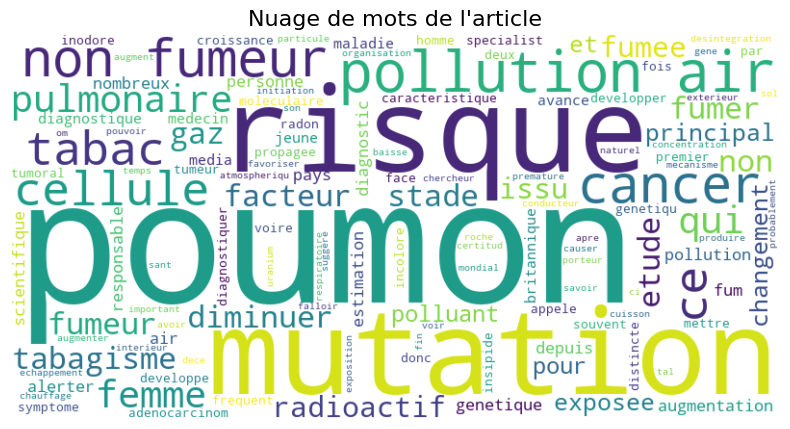

In [ ]:
# Génération d'un nuage de mots (WordCloud) à partir du texte nettoyé

from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Joindre tous les documents en une seule chaîne de caractères
texte_complet = ' '.join(corpus_lemmatise)
# Créer le nuage de mots
nuage_mots = WordCloud(width=800, height=400, background_color='white').generate(texte_complet)
# Afficher le nuage de mots
plt.figure(figsize=(10, 5))
plt.imshow(nuage_mots, interpolation='bilinear')
plt.axis('off')  # Ne pas afficher les axes
plt.title("Nuage de mots de l'article", fontsize=16)
plt.show()
